In [ ]:
## Mount Google Drive Data (If using Google Colaboratory)
try:
    from google.colab import drive
    drive.mount('/content/gdrive')
except:
    print("Mounting Failed.")

Mounted at /content/gdrive


In [ ]:
## Standard Library
import os
import json
import random
## External Libraries
import numpy as np
import torch
import torch.nn as nn
from torchvision import transforms
from torch.autograd import Variable
import torch.nn.functional as functional
from torch.utils.data import Dataset, DataLoader
from torch.nn.parameter import Parameter
import torch.nn.functional as F
from skimage import io
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image

import cv2
!pip install livelossplot

     |████████████████████████████████| 793 kB 19.4 MB/s 
     |████████████████████████████████| 381 kB 90.9 MB/s 
  Attempting uninstall: prompt-toolkit
    Found existing installation: prompt-toolkit 1.0.18
    Uninstalling prompt-toolkit-1.0.18:
      Successfully uninstalled prompt-toolkit-1.0.18
  Attempting uninstall: ipython
    Found existing installation: ipython 5.5.0
    Uninstalling ipython-5.5.0:
      Successfully uninstalled ipython-5.5.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
jupyter-console 5.2.0 requires prompt-toolkit<2.0.0,>=1.0.0, but you have prompt-toolkit 3.0.29 which is incompatible.
google-colab 1.0.0 requires ipython~=5.5.0, but you have ipython 7.33.0 which is incompatible.


In [ ]:
# General Data Directory
data_dir = "./gdrive/MyDrive/DL_final_data"

## Challenge + Test Paths
challenge_dir_list = [f"miccai_challenge_release_{i+1}" for i in range(4)]

In [ ]:
def RGBlabel2Gray(label):
  return round(0.299*label[2] + 0.587*label[1] + 0.114*label[0])

**Dataloader**

In [ ]:
import natsort as natsort
## Image Dataloader
class ImageDataset(Dataset):

    """
    ImageDataset
    """

    def __init__(self,
                 input_dir,
                 seq_idx,
                 stereo=False,
                 transforms=None):
        """
        Args:
            input_dir (str): Path to either challenge directory
            or test directory
            mask_json_path (str): Path to label.json file
            transforms (list or None): Image transformations to apply upon loading.
        """
        self.stereo = stereo
        self.transform = transforms
        input_dir = os.path.join(data_dir, input_dir)
        seq_list = os.listdir(input_dir)
        seq_list.sort()
        if input_dir[-3] == 'e':
          # get masks from labels.json
          mask_json_path = os.path.join(input_dir, 'labels.json')
          with open(mask_json_path, 'r') as f:
            self.labels = json.load(f)
          self.mask_num = len(self.labels)
          # get 'seq_' dir
          seq_list.pop(0)
          self.data_dir_list = [os.path.join(input_dir, seq_list[i]) for i in range(len(seq_list))]
          self.data_dir = self.data_dir_list[seq_idx]

        elif input_dir[-1] == 'a':
          # get masks from labels.json
          mask_json_path = os.path.join(data_dir, 'labels.json')
          with open(mask_json_path, 'r') as f:
            self.labels = json.load(f)
          self.mask_num = len(self.labels)
          # get 'seq_' dir
          self.data_dir_list = [os.path.join(input_dir, seq_list[i]) for i in range(len(seq_list))]
          self.data_dir = self.data_dir_list[seq_idx]
        else:
          print('Wrong input_dir!')

    def __len__(self):
        """

        """
        label_path = os.path.join(self.data_dir, 'labels')
        return sum([i.endswith('png') for i in os.listdir(label_path)])

    def __getitem__(self,
                    idx):
        """

        """
        ## just left frames
        if not self.stereo:
          mask_name = img_name = 'frame' + str(idx).zfill(3) + '.png'
          img = io.imread(os.path.join(self.data_dir, 'left_frames', img_name))

          # read as BGR
          mask = cv2.imread(os.path.join(self.data_dir, 'labels', mask_name))
          gray_mask = cv2.cvtColor(mask, cv2.COLOR_RGB2GRAY)
          h, w = gray_mask.shape

          ## Convert grey-scale label to one-hot encoding
          new_mask = np.zeros((h, w, self.mask_num))
          for i in range(self.mask_num):
            m_color = self.labels[i]['color']
            # print(i, m_color, RGBlabel2Gray(m_color))
            new_mask[:, :, i] = gray_mask == RGBlabel2Gray(m_color)

          if self.transform:
              img, gray_mask = self.img_transform(img, new_mask)
              # print('img',img)
          return img, gray_mask



    def img_transform(self,
                      img,
                      mask):
        """

        """
        ## Apply Transformations to Image and Mask
        seed = np.random.randint(42)
        random.seed(seed)
        img = self.transform(img)
        mask = self.transform(mask)
        return img, mask


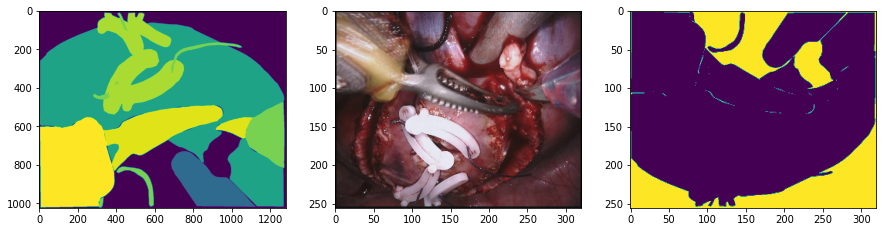

In [ ]:
from torchvision.transforms.transforms import RandomCrop
# seed = np.random.randint(42)

p1 = random.randint(0,1)
p2 = random.randint(0,1)

img_transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Resize([256, 320]),
        transforms.RandomHorizontalFlip(p1),
        transforms.RandomVerticalFlip(p2),
])

train_dataset = ImageDataset(challenge_dir_list[0], 1, transforms=img_transform)
train_dataloader = DataLoader(train_dataset, batch_size=1, shuffle=True)

idx = 148
mask_name = img_name = 'frame' + str(idx).zfill(3) + '.png'
img = io.imread(os.path.join(data_dir, challenge_dir_list[0], 'seq_1', 'labels', img_name))

gray_mask = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

plt.figure(figsize=(15,15))

plt.subplot(1,3,1)
plt.imshow(gray_mask)

img, mask = train_dataset[idx]

plt.subplot(1,3,2)
img=img.permute(1,2,0)
plt.imshow(img)

plt.subplot(1,3,3)
mask=mask.permute(1,2,0)
plt.imshow(mask[:,:,0])

Show each channel of the mask

torch.Size([256, 320, 12])


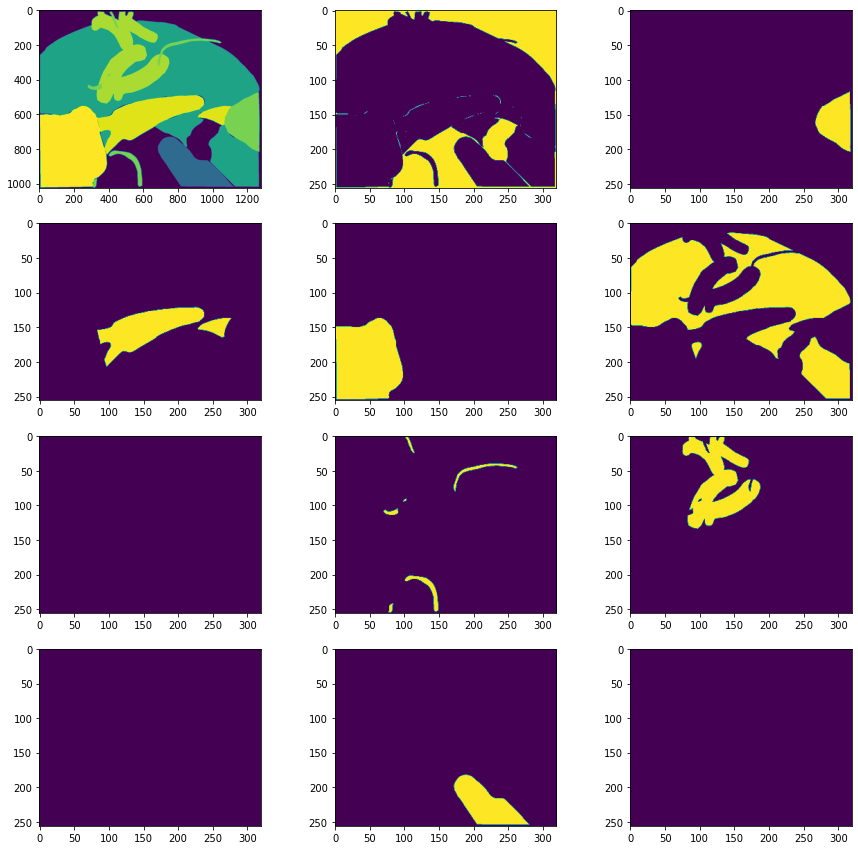

In [ ]:
img, msk = train_dataset[idx]
plt.figure(figsize=(15,15))
plt.subplot(4,3,1)
plt.imshow(gray_mask)

msk = msk.permute(1,2,0)
print(msk.shape)
for i in range(11):
  plt.subplot(4,3,i+2)
  plt.imshow(msk[:,:,i])

In [ ]:
## Convert one-hot encoding to RGB image
def onehot_to_rgb(onehot, color_dict):
  onehot = onehot.cpu().squeeze(0)
  single_layer = torch.argmax(onehot, axis=0)
  output = np.zeros([onehot.shape[1], onehot.shape[2], 4])

  for i in range(len(color_dict)):
      output[single_layer==i] = color_dict[i]['color']
  return np.uint8(output)

Test convert one-hot to RGB image

torch.Size([12, 256, 320])


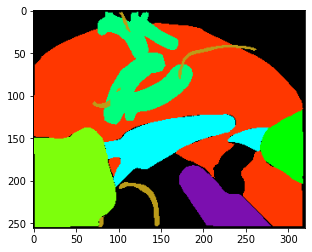

In [ ]:
data_dir2 = "./gdrive/MyDrive/DL_final_data/miccai-2018-code"
mask_json_path = os.path.join(data_dir2, 'labels.json')
with open(mask_json_path, 'r') as f:
  labels = json.load(f)
color_dict = labels['classes']
print(msk.shape)
img = onehot_to_rgb(msk, color_dict)
plt.imshow(img[:,:,:3])
plt.show()

See the distribution of classes in the train dataset

count_class [0, 1, 2, 3, 4, 6, 7, 0, 1, 2, 3, 4, 6, 7, 0, 1, 2, 3, 4, 6, 7, 0, 1, 2, 3, 4, 6, 7, 0, 1, 2, 3, 4, 6, 7, 0, 1, 2, 3, 4, 6, 7, 0, 1, 2, 3, 4, 6, 7, 0, 1, 2, 3, 4, 6, 7, 0, 1, 2, 3, 4, 6, 7, 0, 1, 2, 3, 4, 6, 7, 0, 1, 2, 3, 4, 6, 7, 0, 1, 2, 3, 4, 6, 7, 0, 1, 2, 3, 4, 6, 7, 0, 1, 2, 3, 4, 6, 7, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 3, 4, 6, 0, 1, 2, 

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


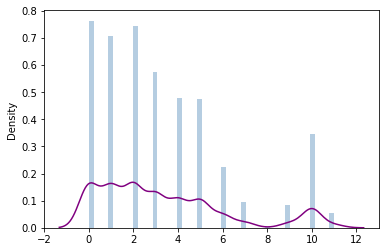

In [ ]:
img_transform = transforms.Compose([
        transforms.ToTensor()])

# con_dataset = torch.utils.data.ConcatDataset([ImageDataset(challenge_dir_list[1], 1, transforms=img_transform),
#                                               ImageDataset(challenge_dir_list[1], 2, transforms=img_transform)])
# train_dataset = torch.utils.data.ConcatDataset([con_dataset,
#                                                 ImageDataset(challenge_dir_list[1], 3, transforms=img_transform)])
train_dataset = ImageDataset(input_dir=challenge_dir_list[0], seq_idx=1, transforms=img_transform)
for i in range(len(challenge_dir_list)):
  for j in range(len(os.listdir(os.path.join(data_dir, challenge_dir_list[i])))-1):
    if i == 0 and j == 0:
      continue
    train_dataset = torch.utils.data.ConcatDataset([train_dataset, ImageDataset(challenge_dir_list[i], j, transforms=img_transform)])
# Random split a validation set
# count_class = np.zeros(12)
count_class = []
for i in range(train_dataset.__len__()):
  img, mask = train_dataset[i]
  for j in range(12):
    # print(mask[j,:,:].sum())
    if mask[j,:,:].sum() > 0:
      count_class.append(j)
print('count_class', count_class)

sns.distplot(count_class, bins=50, hist=True, kde=True, rug=False,
                 hist_kws={"color": "steelblue"}, kde_kws={"color": "purple"})
plt.show()

TernausNet: U-Net with VGG11 Encoder Pre-Trained on ImageNet for Image Segmentation\

By Vladimir Iglovikov and Alexey Shvets

In [ ]:
import torch
import torchvision
from torch import nn
from torch.nn import functional as F
from torchvision import models


def conv3x3(in_, out):
    return nn.Conv2d(in_, out, 3, padding=1)


class ConvRelu(nn.Module):
    def __init__(self, in_: int, out: int):
        super(ConvRelu, self).__init__()
        self.conv = conv3x3(in_, out)
        self.activation = nn.ReLU(inplace=True)

    def forward(self, x):
        x = self.conv(x)
        x = self.activation(x)
        return x


class DecoderBlock(nn.Module):
    """
    Paramaters for Deconvolution were chosen to avoid artifacts, following
    link https://distill.pub/2016/deconv-checkerboard/
    """

    def __init__(self, in_channels, middle_channels, out_channels, is_deconv=True):
        super(DecoderBlock, self).__init__()
        self.in_channels = in_channels

        if is_deconv:
            self.block = nn.Sequential(
                ConvRelu(in_channels, middle_channels),
                nn.ConvTranspose2d(middle_channels, out_channels, kernel_size=4, stride=2,
                                   padding=1),
                nn.ReLU(inplace=True)
            )
        else:
            self.block = nn.Sequential(
                nn.Upsample(scale_factor=2, mode='bilinear'),
                ConvRelu(in_channels, middle_channels),
                ConvRelu(middle_channels, out_channels),
            )

    def forward(self, x):
        return self.block(x)

class UNet11(nn.Module):
    def __init__(self, num_classes=12, num_filters=32, pretrained=True):
        """
        :param num_classes:
        :param num_filters:
        :param pretrained:
            False - no pre-trained network used
            True - encoder pre-trained with VGG11
        """
        super().__init__()
        self.pool = nn.MaxPool2d(2, 2)

        self.num_classes = num_classes

        self.encoder = models.vgg11(pretrained=pretrained).features

        self.relu = nn.ReLU(inplace=True)
        self.conv1 = nn.Sequential(self.encoder[0],
                                   self.relu)

        self.conv2 = nn.Sequential(self.encoder[3],
                                   self.relu)

        self.conv3 = nn.Sequential(
            self.encoder[6],
            self.relu,
            self.encoder[8],
            self.relu,
        )
        self.conv4 = nn.Sequential(
            self.encoder[11],
            self.relu,
            self.encoder[13],
            self.relu,
        )

        self.conv5 = nn.Sequential(
            self.encoder[16],
            self.relu,
            self.encoder[18],
            self.relu,
        )

        self.center = DecoderBlock(256 + num_filters * 8, num_filters * 8 * 2, num_filters * 8, is_deconv=True)
        self.dec5 = DecoderBlock(512 + num_filters * 8, num_filters * 8 * 2, num_filters * 8, is_deconv=True)
        self.dec4 = DecoderBlock(512 + num_filters * 8, num_filters * 8 * 2, num_filters * 4, is_deconv=True)
        self.dec3 = DecoderBlock(256 + num_filters * 4, num_filters * 4 * 2, num_filters * 2, is_deconv=True)
        self.dec2 = DecoderBlock(128 + num_filters * 2, num_filters * 2 * 2, num_filters, is_deconv=True)
        self.dec1 = ConvRelu(64 + num_filters, num_filters)

        self.final = nn.Conv2d(num_filters, num_classes, kernel_size=1)

    def forward(self, x):
        conv1 = self.conv1(x)
        conv2 = self.conv2(self.pool(conv1))
        conv3 = self.conv3(self.pool(conv2))
        conv4 = self.conv4(self.pool(conv3))
        conv5 = self.conv5(self.pool(conv4))
        center = self.center(self.pool(conv5))

        dec5 = self.dec5(torch.cat([center, conv5], 1))
        dec4 = self.dec4(torch.cat([dec5, conv4], 1))
        dec3 = self.dec3(torch.cat([dec4, conv3], 1))
        dec2 = self.dec2(torch.cat([dec3, conv2], 1))
        dec1 = self.dec1(torch.cat([dec2, conv1], 1))

        x_out = F.softmax(self.final(dec1), dim=1)

        return x_out


class Interpolate(nn.Module):
    def __init__(
        self,
        size: int = None,
        scale_factor: int = None,
        mode: str = "nearest",
        align_corners: bool = False,
    ):
        super().__init__()
        self.interp = nn.functional.interpolate
        self.size = size
        self.mode = mode
        self.scale_factor = scale_factor
        self.align_corners = align_corners

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        x = self.interp(
            x,
            size=self.size,
            scale_factor=self.scale_factor,
            mode=self.mode,
            align_corners=self.align_corners,
        )
        return x


class DecoderBlockV2(nn.Module):
    def __init__(
        self,
        in_channels: int,
        middle_channels: int,
        out_channels: int,
        is_deconv: bool = True,
    ):
        super().__init__()
        self.in_channels = in_channels

        if is_deconv:
            """
                Paramaters for Deconvolution were chosen to avoid artifacts, following
                link https://distill.pub/2016/deconv-checkerboard/
            """

            self.block = nn.Sequential(
                ConvRelu(in_channels, middle_channels),
                nn.ConvTranspose2d(
                    middle_channels, out_channels, kernel_size=4, stride=2, padding=1
                ),
                nn.ReLU(inplace=True),
            )
        else:
            self.block = nn.Sequential(
                Interpolate(scale_factor=2, mode="bilinear"),
                ConvRelu(in_channels, middle_channels),
                ConvRelu(middle_channels, out_channels),
            )

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        return self.block(x)


class UNet16(nn.Module):
    def __init__(
        self,
        num_classes: int = 1,
        num_filters: int = 32,
        pretrained: bool = False,
        is_deconv: bool = False,
    ):
        """
        Args:
            num_classes:
            num_filters:
            pretrained:
                False - no pre-trained network used
                True - encoder pre-trained with VGG16
            is_deconv:
                False: bilinear interpolation is used in decoder
                True: deconvolution is used in decoder
        """
        super().__init__()
        self.num_classes = num_classes

        self.pool = nn.MaxPool2d(2, 2)

        self.encoder = torchvision.models.vgg16(pretrained=pretrained).features

        self.relu = nn.ReLU(inplace=True)

        self.conv1 = nn.Sequential(
            self.encoder[0], self.relu, self.encoder[2], self.relu
        )

        self.conv2 = nn.Sequential(
            self.encoder[5], self.relu, self.encoder[7], self.relu
        )

        self.conv3 = nn.Sequential(
            self.encoder[10],
            self.relu,
            self.encoder[12],
            self.relu,
            self.encoder[14],
            self.relu,
        )

        self.conv4 = nn.Sequential(
            self.encoder[17],
            self.relu,
            self.encoder[19],
            self.relu,
            self.encoder[21],
            self.relu,
        )

        self.conv5 = nn.Sequential(
            self.encoder[24],
            self.relu,
            self.encoder[26],
            self.relu,
            self.encoder[28],
            self.relu,
        )

        self.center = DecoderBlockV2(
            512, num_filters * 8 * 2, num_filters * 8, is_deconv
        )

        self.dec5 = DecoderBlockV2(
            512 + num_filters * 8, num_filters * 8 * 2, num_filters * 8, is_deconv
        )
        self.dec4 = DecoderBlockV2(
            512 + num_filters * 8, num_filters * 8 * 2, num_filters * 8, is_deconv
        )
        self.dec3 = DecoderBlockV2(
            256 + num_filters * 8, num_filters * 4 * 2, num_filters * 2, is_deconv
        )
        self.dec2 = DecoderBlockV2(
            128 + num_filters * 2, num_filters * 2 * 2, num_filters, is_deconv
        )
        self.dec1 = ConvRelu(64 + num_filters, num_filters)
        self.final = nn.Conv2d(num_filters, num_classes, kernel_size=1)

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        conv1 = self.conv1(x)
        conv2 = self.conv2(self.pool(conv1))
        conv3 = self.conv3(self.pool(conv2))
        conv4 = self.conv4(self.pool(conv3))
        conv5 = self.conv5(self.pool(conv4))

        center = self.center(self.pool(conv5))

        dec5 = self.dec5(torch.cat([center, conv5], 1))

        dec4 = self.dec4(torch.cat([dec5, conv4], 1))
        dec3 = self.dec3(torch.cat([dec4, conv3], 1))
        dec2 = self.dec2(torch.cat([dec3, conv2], 1))
        dec1 = self.dec1(torch.cat([dec2, conv1], 1))
        if self.num_classes > 1:
          # x_out = F.log_softmax(self.final(dec1), dim=1)
          x_out = F.softmax(self.final(dec1), dim=1)
        else:
          x_out = self.final(dec1)
        return x_out

DICELoss

In [ ]:
class DICELoss(nn.Module):
    def __init__(self):
      super(DICELoss, self).__init__()
      self.eps = 1e-6

    def forward(self, predict, target):
      """
			predict tesor of shape = (N, C, H, W)
			target tensor of shape = (N, C, H, W)
		  """
      predict = F.softmax(predict, dim=1)

      dims = (1, 2, 3)
      intersection = torch.sum(predict * target, dims)
      union = torch.sum(predict + target, dims)
      denominator = torch.sum(predict ** 2 + target ** 2, dims)
      # dice_score = (2*intersection+ self.eps) / (union + self.eps)
      dice_score = (2*intersection) / (denominator)
      return torch.mean(1. - dice_score)


In [ ]:
class IoULoss(nn.Module):
    def __init__(self):
      super(IoULoss, self).__init__()
      self.eps = 1e-6

    def forward(self, predict, target):
      """
			predict tesor of shape = (N, C, H, W)
			target tensor of shape = (N, C, H, W)
		  """
      predict = F.softmax(predict, dim=1)
      dims = (1, 2, 3)
      intersection = torch.sum(predict * target, dims)
      union = torch.sum(predict + target, dims)
      iou = (intersection + self.eps) / (union + self.eps)
      thresholded = torch.clamp(20 * (iou - 0.5), 0, 10).ceil() / 10
      return torch.mean(1. - thresholded)

Lovasz softmax Loss

In [ ]:
## Helper
def isnan(x):
    return x != x


def mean(l, ignore_nan=False, empty=0):
    """
    nanmean compatible with generators.
    """
    l = iter(l)
    try:
        n = 1
        acc = next(l)
    except StopIteration:
        if empty == 'raise':
            raise ValueError('Empty mean')
        return empty
    for n, v in enumerate(l, 2):
        acc += v
    if n == 1:
        return acc
    return acc / n

def lovasz_grad(gt_sorted):
    """
    Computes gradient of the Lovasz extension w.r.t sorted errors
    See Alg. 1 in paper
    """
    p = len(gt_sorted)
    gts = gt_sorted.sum()
    intersection = gts - gt_sorted.float().cumsum(0)
    union = gts + (1 - gt_sorted).float().cumsum(0)
    jaccard = 1. - intersection / union
    if p > 1: # cover 1-pixel case
        jaccard[1:p] = jaccard[1:p] - jaccard[0:-1]
    return jaccard

## Multiclass loss
def lovasz_softmax(probas, labels, classes='present', per_image=False, ignore=None):
    """
    Multi-class Lovasz-Softmax loss
      probas: [B, C, H, W] Variable, class probabilities at each prediction (between 0 and 1).
              Interpreted as binary (sigmoid) output with outputs of size [B, H, W].
      labels: [B, H, W] Tensor, ground truth labels (between 0 and C - 1)
      classes: 'all' for all, 'present' for classes present in labels, or a list of classes to average.
      per_image: compute the loss per image instead of per batch
      ignore: void class labels
    """
    # one-hot to single layer
    labels = torch.argmax(labels, axis=1)
    if per_image:
        loss = mean(lovasz_softmax_flat(*flatten_probas(prob.unsqueeze(0), lab.unsqueeze(0), ignore), classes=classes)
                          for prob, lab in zip(probas, labels))
    else:
        loss = lovasz_softmax_flat(*flatten_probas(probas, labels, ignore), classes=classes)
    return loss


def lovasz_softmax_flat(probas, labels, classes='present'):
    """
    Multi-class Lovasz-Softmax loss
      probas: [P, C] Variable, class probabilities at each prediction (between 0 and 1)
      labels: [P] Tensor, ground truth labels (between 0 and C - 1)
      classes: 'all' for all, 'present' for classes present in labels, or a list of classes to average.
    """
    if probas.numel() == 0:
        # only void pixels, the gradients should be 0
        return probas * 0.
    C = probas.size(1)
    losses = []
    class_to_sum = list(range(C)) if classes in ['all', 'present'] else classes
    for c in class_to_sum:
        fg = (labels == c).float() # foreground for class c
        if (classes is 'present' and fg.sum() == 0):
            continue
        if C == 1:
            if len(classes) > 1:
                raise ValueError('Sigmoid output possible only with 1 class')
            class_pred = probas[:, 0]
        else:
            class_pred = probas[:, c]
        errors = (Variable(fg) - class_pred).abs()
        errors_sorted, perm = torch.sort(errors, 0, descending=True)
        perm = perm.data
        fg_sorted = fg[perm]
        losses.append(torch.dot(errors_sorted, Variable(lovasz_grad(fg_sorted))))
    return mean(losses)


def flatten_probas(probas, labels, ignore=None):
    """
    Flattens predictions in the batch
    """
    if probas.dim() == 3:
        # assumes output of a sigmoid layer
        B, H, W = probas.size()
        probas = probas.view(B, 1, H, W)
    B, C, H, W = probas.size()
    probas = probas.permute(0, 2, 3, 1).contiguous().view(-1, C)  # B * H * W, C = P, C
    labels = labels.view(-1)
    if ignore is None:
        return probas, labels
    valid = (labels != ignore)
    vprobas = probas[valid.nonzero().squeeze()]
    vlabels = labels[valid]
    return vprobas, vlabels

Training

In [ ]:
torch.cuda.empty_cache()
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f'Using {device} device')

Using cuda device


In [ ]:

def train_loop(dataloader, model, criterion, optimizer):
    model.train() # prep model for training
    train_loss = 0.0

    for batch, (data, target) in enumerate(dataloader):
        data = data.to(device, dtype=torch.float)
        target = target.to(device)
        # clear the gradients of all optimized variables
        optimizer.zero_grad()
        # forward pass: compute predicted outputs by passing inputs to the model
        predict = model(data)
        # calculate the loss
        # loss = criterion(predict, target)
        loss = lovasz_softmax(predict, target)
        # backward pass: compute gradient of the loss with respect to model parameters
        loss.backward()
        # perform a single optimization step (parameter update)
        optimizer.step()

        # update running training loss
        train_loss += loss.item()

    # calculate average loss over an epoch
    train_loss = train_loss/len(train_dataloader)
    return train_loss

def evaluate(model, dataloader, criterion, device):

    eval_loss = 0
    model.eval()

    with torch.no_grad():
        for (x, y) in dataloader:

            x = x.to(device)
            y = y.to(device)
            y_pred = model(x)

            # loss = criterion(y_pred, y)
            loss = lovasz_softmax(y_pred, y)
            eval_loss += loss.item()
    eval_loss = eval_loss / len(dataloader)
    return eval_loss


In [ ]:
import time
from livelossplot import PlotLosses
os.chdir('./gdrive/MyDrive/')
from pytorchtools import EarlyStopping
os.chdir('/content/')
liveloss = PlotLosses()
# Hyper params
learning_rate = 0.6e-03
n_classes = 12
train_batch_size = 20
validation_batch_size = 20
num_epochs = 200
## Initialize your unet
model = UNet11(12, pretrained=True).to(device)
p1 = random.randint(0,1)
p2 = random.randint(0,1)
img_transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Resize([256, 320]),
        transforms.RandomVerticalFlip(p1),
        transforms.RandomHorizontalFlip(p2),
])

## Initialize Dataloaders
# train_dataset=ImageDataset(input_dir=challenge_dir_list[0], seq_idx=0, transforms=img_transform)

train_dataset = ImageDataset(input_dir=challenge_dir_list[0], seq_idx=1, transforms=img_transform)
for i in range(len(challenge_dir_list)):
  for j in range(len(os.listdir(os.path.join(data_dir, challenge_dir_list[i])))-1):
    if i == 0 and j == 0:
      continue
    train_dataset = torch.utils.data.ConcatDataset([train_dataset, ImageDataset(challenge_dir_list[i], j, transforms=img_transform)])
# Random split a validation set
length=train_dataset.__len__()
# train_size=int(0.8*length)
# validate_size = int(length - train_size)
# train_dataset, validation_dataset = torch.utils.data.random_split(train_dataset,[train_size, validate_size])

split = length // 5
print(split)
indices = list(range(length))
np.random.shuffle(indices)

train_sampler = torch.utils.data.sampler.SubsetRandomSampler(indices[:split])
valid_sampler = torch.utils.data.sampler.SubsetRandomSampler(indices[split:int(1.2*split)])

# train_sampler = torch.utils.data.sampler.SubsetRandomSampler(indices[:int(0.8*split)])
# valid_sampler = torch.utils.data.sampler.SubsetRandomSampler(indices[int(0.8*split):split])

train_dataloader = DataLoader(train_dataset, batch_size=train_batch_size, sampler=train_sampler, shuffle=False)
validation_dataloader = DataLoader(train_dataset, batch_size=validation_batch_size, sampler=valid_sampler, shuffle=False)

## Initialize Optimizer and Learning Rate Scheduler
optimizer = torch.optim.Adam(model.parameters(),lr=learning_rate)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=20, gamma=0.1)
# criterion = DICELoss()
# criterion = IoULoss()
criterion = None

447


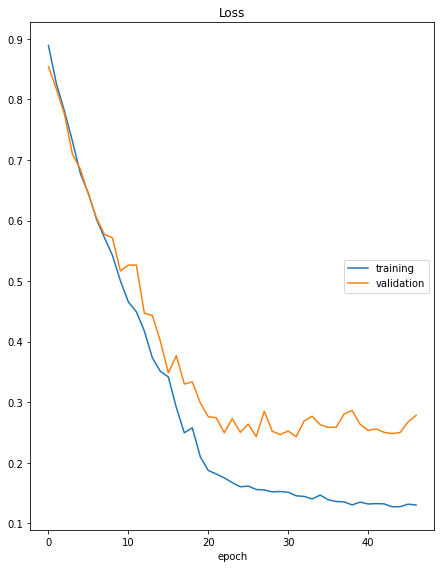

Loss
	training         	 (min:    0.127, max:    0.889, cur:    0.130)
	validation       	 (min:    0.243, max:    0.854, cur:    0.278)
epoch time: 183.8743269443512
EarlyStopping counter: 15 out of 15
Early stopping


In [ ]:
early_stopping = EarlyStopping(patience=15, verbose=True, path='Unet16.pt')
print("Start Training...")
for epoch in range(num_epochs):
    start = time.time()
    ########################### Training #####################################
    print("\nEPOCH " +str(epoch+1)+" of "+str(num_epochs)+"\n")
    train_loss = train_loop(train_dataloader, model, criterion, optimizer)
    scheduler.step()
    lr = scheduler.get_last_lr()
    print('last learning rate:', lr[0])
    print('train_loss:', train_loss)

    ########################### Validation #####################################
    val_loss = evaluate(model, validation_dataloader, criterion, device)
    print('val_loss:', val_loss)
    end = time.time()

    liveloss.update({
              'loss': train_loss,
              'val_loss': val_loss
              })
    liveloss.send()
    print('epoch time:', end-start)
    #test
    early_stopping(val_loss, model)
    if early_stopping.early_stop:
      print("Early stopping")
      break


Evaluation part

Load testset

In [ ]:

img_transform = transforms.Compose([
        transforms.ToTensor(),
        # transforms.Resize([1024, 1280])
        transforms.Resize([256, 320])
])
# test_dataset=ImageDataset(input_dir=challenge_dir_list[1], seq_idx=2, transforms=img_transform)

test_dataset1=ImageDataset(input_dir='test_data', seq_idx=0, transforms=img_transform)
test_dataloader1 = DataLoader(test_dataset1, batch_size=1, shuffle=False)
test_dataset2=ImageDataset(input_dir='test_data', seq_idx=1, transforms=img_transform)
test_dataloader2 = DataLoader(test_dataset2, batch_size=1, shuffle=False)
test_dataset3=ImageDataset(input_dir='test_data', seq_idx=2, transforms=img_transform)
test_dataloader3 = DataLoader(test_dataset3, batch_size=1, shuffle=False)
test_dataset4=ImageDataset(input_dir='test_data', seq_idx=3, transforms=img_transform)
test_dataloader4 = DataLoader(test_dataset4, batch_size=1, shuffle=False)
model.load_state_dict(torch.load('Unet16.pt'))
dataloader_list = [test_dataloader1,test_dataloader2,test_dataloader3,test_dataloader4]

test_data_dir = os.path.join(data_dir, 'test_data', 'seq_1', 'labels')

submission_list = []
for num in range(4):
  submission_data_dir = os.path.join(data_dir, 'submission', f'seq_{num+1}')
  submission_list.append(submission_data_dir)
  if not os.path.exists(submission_data_dir):
    os.makedirs(submission_data_dir)

## Load the label color_dict
mask_json_path = os.path.join(data_dir, 'final_evaluation', 'labels.json')

with open(mask_json_path, 'r') as f:
  labels = json.load(f)
color_dict = labels['classes']

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

In [ ]:
def label_accuracy(probas, true_1_hot):
    """Computes the accuracy.
    Args:
        probas: a tensor of shape [B, C, H, W] of probabilities
        true_1_hot: a tensor of shape [B, C, H, W]. Corresponds to the true label
    Returns:
        tp: [C] true positive of c classes
        fp: [C] false positive
        fn: [C] false negative
    """
    num_class = probas.shape[1]
    num_batch = probas.shape[0]

    pred = torch.max(probas,dim=1)[1]
    pred_1_hot = torch.eye(num_class)[pred.squeeze(1)]
    pred_1_hot = pred_1_hot.permute(0, 3, 1, 2).float()

    # sum all except class axis
    tp = torch.mul(pred_1_hot, true_1_hot).sum(dim=3).sum(dim=2).sum(dim=0)
    fp = pred_1_hot.sum(dim=3).sum(dim=2).sum(dim=0) - tp
    fn = true_1_hot.sum(dim=3).sum(dim=2).sum(dim=0) - tp

    return tp, fp, fn

In [ ]:
## Evaluate mIoU scores

model.eval()
num_class = 12
tp = torch.zeros(num_class)
fp = torch.zeros(num_class)
fn = torch.zeros(num_class)
test_dice_list = []
torch.set_printoptions(precision=3, sci_mode=False)
for test_num in range(4):
  print(f'<<<<<<<<<<<<<<<<<<<<seq_{test_num+1}<<<<<<<<<<<<<<<<<<<<<<<')
  for i, data in enumerate(dataloader_list[test_num]):
      ## Format Data
      img, target = data
      img = img.cuda()
      target = target.cuda()
      ## Make Predictions
      out = model(img)
      # probas = F.softmax(out, dim=1)
      probas = out
      curr_tp, curr_fp, curr_fn = label_accuracy(probas.cpu(), target.cpu())
      tp += curr_tp
      fp += curr_fp
      fn += curr_fn
      # curr_dice = ((2*curr_tp + 1e-7)/ (2*curr_tp+curr_fp+curr_fn+1e-7))
      mIoU = ((tp + 1e-7)/ (tp+fp+fn+1e-7)).mean()
  test_dice_list.append(mIoU)
print(((tp + 1e-7)/ (tp+fp+fn+1e-7)))
print(f'mIoU score:', mIoU)

<<<<<<<<<<<<<<<<<<<<seq_1<<<<<<<<<<<<<<<<<<<<<<<
<<<<<<<<<<<<<<<<<<<<seq_2<<<<<<<<<<<<<<<<<<<<<<<
<<<<<<<<<<<<<<<<<<<<seq_3<<<<<<<<<<<<<<<<<<<<<<<
<<<<<<<<<<<<<<<<<<<<seq_4<<<<<<<<<<<<<<<<<<<<<<<
tensor([    0.664,     0.809,     0.396,     0.502,     0.664,     0.177,
            0.028,     0.562,     0.000,     0.000,     0.326,     0.173])
mIoU score: tensor(0.358)


In [ ]:
def IoU(model, test_dataloader, num_classes, use_gpu):
    TP = np.zeros(num_classes).astype(np.int)
    FP = np.zeros(num_classes).astype(np.int)
    FN = np.zeros(num_classes).astype(np.int)
    iou = np.zeros(num_classes)
    model.eval()
    for data in test_dataloader:
        img, target = data
        if use_gpu:
            img = img.cuda()
            target = target.cuda()
        out = model(img)
        target = torch.argmax(target, dim = 1)
        predict = torch.argmax(out, dim = 1)
        for cl in range(num_classes):
            gt_mask = (target == cl)
            pred_mask = (predict == cl)
            TP[cl] += (predict[gt_mask] == cl).sum()
            FP[cl] += (target[pred_mask] != cl).sum()
            FN[cl] += (predict[gt_mask] != cl).sum()
            # print("class:",cl,":",TP[cl], FP[cl], FN[cl])
        for cl in range(num_classes):
            if(TP[cl] + FP[cl] + FN[cl] == 0):
              iou[cl] = -1
            else:
              iou[cl] = TP[cl]/(TP[cl] + FP[cl] + FN[cl])
    m_iou = iou[iou>=0].mean()
    print(iou[iou>=0])
    return m_iou

def DICE(model, test_dataloader, num_classes, use_gpu):
  #A false positive is a result that indicates a given condition exists, when it does not
  #A false negative is a test result that indicates that a condition does not hold, while in fact it does
    TP = np.zeros(num_classes).astype(np.int)
    FP = np.zeros(num_classes).astype(np.int)
    FN = np.zeros(num_classes).astype(np.int)
    dice = np.zeros(num_classes)
    model.eval()
    for data in test_dataloader:
        img, target = data
        if use_gpu:
            img = img.cuda()
            target = target.cuda()
        out = model(img)
        target = torch.argmax(target, dim = 1)
        predict = torch.argmax(out, dim = 1)
        for cl in range(num_classes):
            gt_mask = (target == cl)
            pred_mask = (predict == cl)
            TP[cl] += (predict[gt_mask] == cl).sum()
            FP[cl] += (target[pred_mask] != cl).sum()
            FN[cl] += (predict[gt_mask] != cl).sum()
            # print("class:",cl,":",TP[cl], FP[cl], FN[cl])
        for cl in range(num_classes):
            if(2*TP[cl] + FP[cl] + FN[cl] == 0):
              dice[cl] = -1
            else:
              dice[cl] = 2*TP[cl]/(2*TP[cl] + FP[cl] + FN[cl])
    m_dice = dice[dice>=0].mean()
    print(dice[dice>=0])
    return m_dice

mIoU_score1 = IoU(model, test_dataloader1, 12, use_gpu=True)
print(mIoU_score1)
mIoU_score2 = IoU(model, test_dataloader2, 12, use_gpu=True)
print(mIoU_score2)
mIoU_score3 = IoU(model, test_dataloader3, 12, use_gpu=True)
print(mIoU_score3)
mIoU_score4 = IoU(model, test_dataloader4, 12, use_gpu=True)
print(mIoU_score4)
print('overall:',(mIoU_score1+mIoU_score2+mIoU_score3+mIoU_score4)/4)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Depreca

[0.65318    0.71272427 0.29811847 0.4164325  0.50934047 0.
 0.05624958 0.4472829  0.         0.         0.09830033 0.03148013]
0.26859238747023245
[0.60888273 0.8417731  0.34024794 0.33990106 0.49608589 0.14002998
 0.         0.         0.         0.17319221 0.        ]
0.26728299282775625
[0.58591882 0.84929934 0.43861691 0.33202764 0.69450381 0.
 0.         0.         0.         0.00585809 0.        ]
0.26420223777964136
[0.55155191 0.52489722 0.29348006 0.27918814 0.12665801 0.09933337
 0.         0.         0.         0.48393683 0.00550804]
0.21495941652482783
overall: 0.2537592586506145


<<<<<<<<<<<<<<<<<<<<seq_1<<<<<<<<<<<<<<<<<<<<<<<


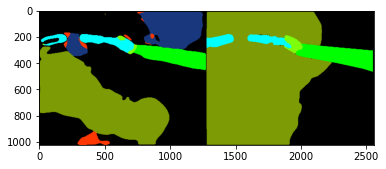

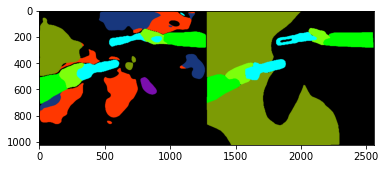

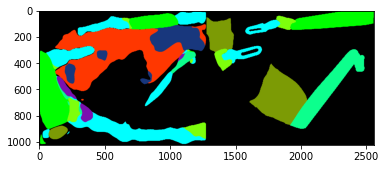

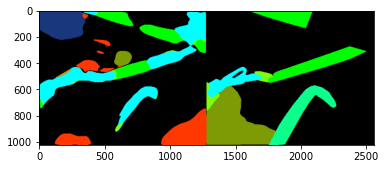

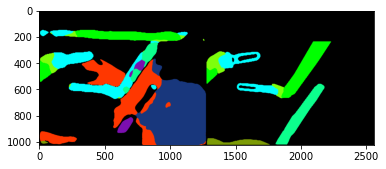

...

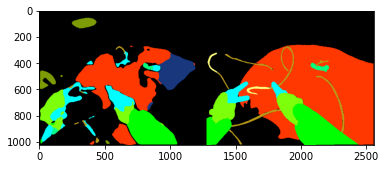

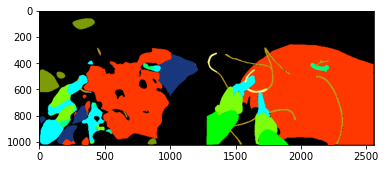

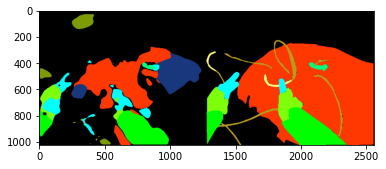

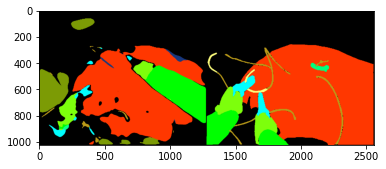

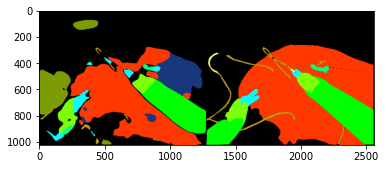

<<<<<<<<<<<<<<<<<<<<seq_2<<<<<<<<<<<<<<<<<<<<<<<


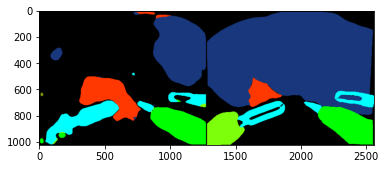

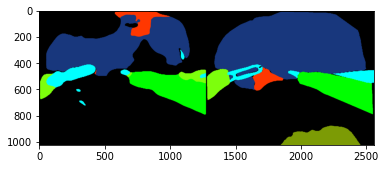

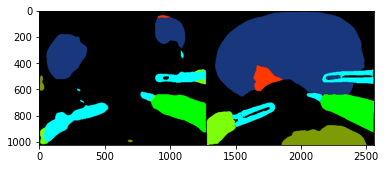

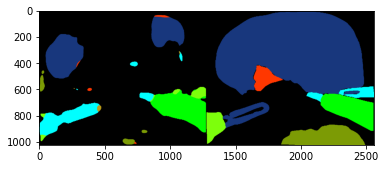

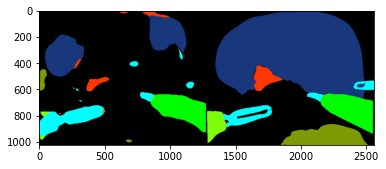

...

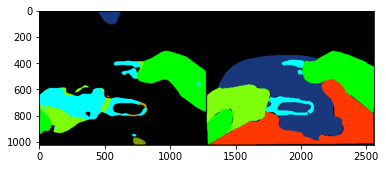

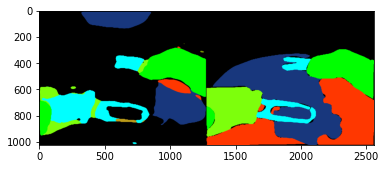

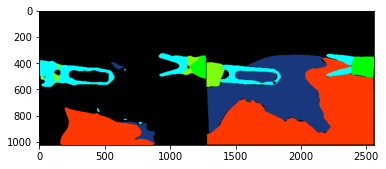

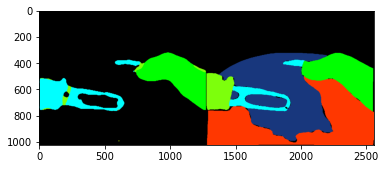

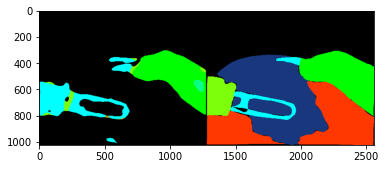

<<<<<<<<<<<<<<<<<<<<seq_3<<<<<<<<<<<<<<<<<<<<<<<


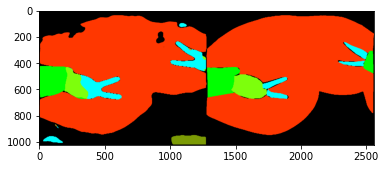

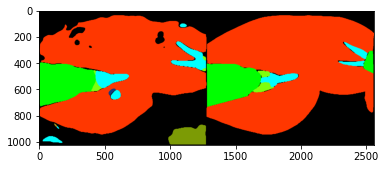

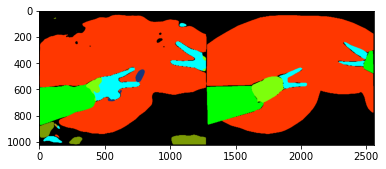

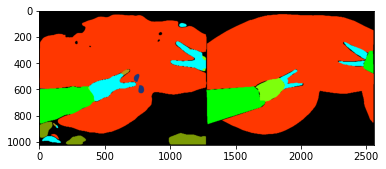

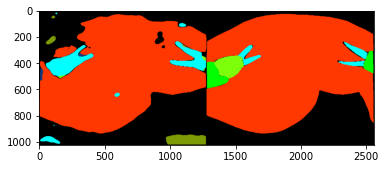

...

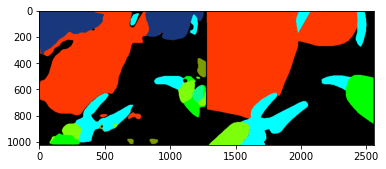

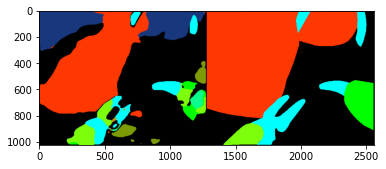

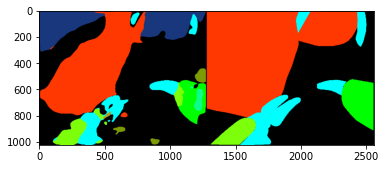

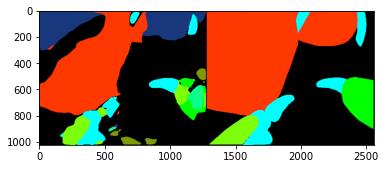

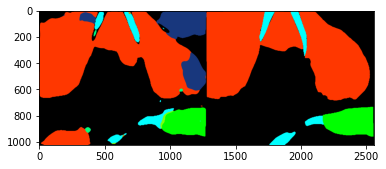

<<<<<<<<<<<<<<<<<<<<seq_4<<<<<<<<<<<<<<<<<<<<<<<


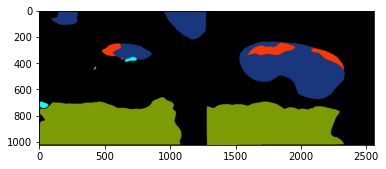

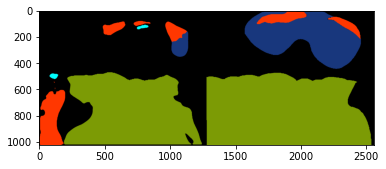

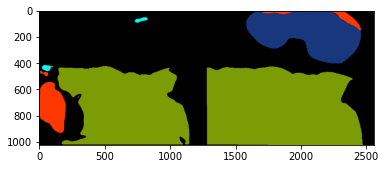

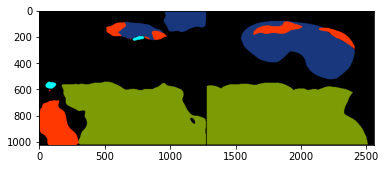

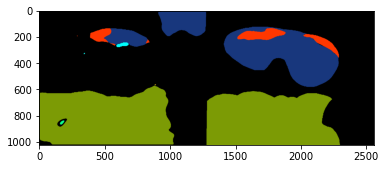

...

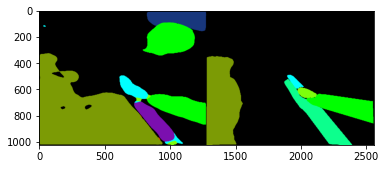

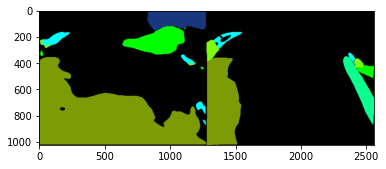

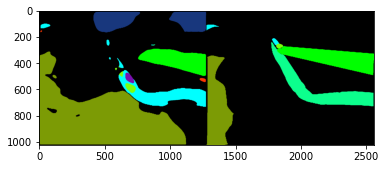

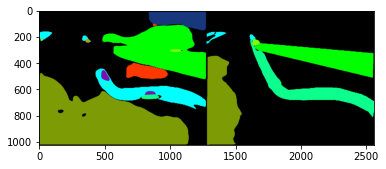

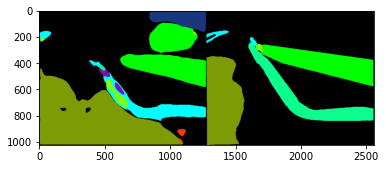

In [ ]:
## Generate inferenced masks

T = transforms.Resize([1024, 1280])
model.eval()
for test_num in range(4):
  for i, data in enumerate(dataloader_list[test_num]):
      ## Format Data
      img, target = data
      img = img.cuda()
      target = target.cuda()
      ## Make Predictions
      out = model(img)
      out = T(out)
      ## The ground truth mask
      gt = T(target)
      gt = onehot_to_rgb(gt, color_dict)

      color_msk = onehot_to_rgb(out, color_dict)
      pred = color_msk[:,:,:3]
      plt.imsave(os.path.join(submission_list[test_num], 'frame' + str(i).zfill(3) + '.png'), color_msk)
      plt.imshow(np.hstack([pred, gt[:,:,:3]]))
      plt.show()




In [ ]:
test_data_dir = os.path.join('..','/test_data/seq_1/labels')


os.chdir('./gdrive/MyDrive/DL_final_data/final_evaluation')
!python run.py --test-data-dir '../test_data/' --submission-dir '../submission/' --output-dir '../output_1/'
# error_and_labels = run.get_error_and_labels()
# run.process(error_and_labels[0], '../test_data/','../submission/')


os.chdir('/content/')


流式输出内容被截断，只能显示最后 5000 行内容。
Adding results for frame frame002.png
Processing score for submission seq1
ious = [0.0035316298964430436]
Processing score for submission seq2
ious = [0.0]
Processing score for submission seq3
ious = [0.352828269806483]
Processing score for submission seq4
ious = [0.0]
Adding results for frame frame003.png
Processing score for submission seq1
ious = [0.020515678624857002]
Processing score for submission seq2
ious = [0.0]
Processing score for submission seq3
ious = [0.2987841156997056]
Processing score for submission seq4
ious = [0.0]
Adding results for frame frame004.png
Processing score for submission seq1
ious = [0.06575703297861131]
Processing score for submission seq2
ious = [0.0]
Processing score for submission seq3
ious = [0.2982392997509394]
Processing score for submission seq4
ious = [0.0]
Adding results for frame frame005.png
Processing score for submission seq1
ious = [0.0018155939345713742]
Processing score for submission seq2
ious = [0.0]
Processi